# FETCHING SPACENET 7 DATASET

In [ ]:
!pip install rasterio geopandas

#1. [Creating GeoDataFrame from raw CSV](https://www.kaggle.com/amerii/spacenet-7-creating-geodataframe-from-raw-csv?scriptVersionId=47741140)


In [ ]:
% cd /content/drive/MyDrive/Colab Notebooks/SPACENET7/DATASET


/content/drive/MyDrive/Colab Notebooks/SPACENET7/DATASET


In [ ]:
import pandas as pd 
import re
from pathlib import Path
import shapely
import geopandas as gpd
from tqdm.notebook import tqdm
tqdm.pandas();

In [ ]:
sample_path = Path('/content/drive/MyDrive/Colab Notebooks/SPACENET7/DATASET/train_final/L15-0595E-1278N_2383_3079_13')
label_csv_path = Path('/content/drive/MyDrive/Colab Notebooks/SPACENET7/DATASET/sn7_train_ground_truth_pix.csv')
output_path = Path.cwd()
output_csv_path = output_path/'output_csvs/'
Path(output_csv_path).mkdir(parents=True, exist_ok=True)
!ls

API   dataset_pruebas  SN7_buildings_train_sample      train_final
csvs  output_csvs      sn7_train_ground_truth_pix.csv  validation_final


In [ ]:
df = pd.read_csv(label_csv_path)
print(df.head())
print(df.info())

                                            filename  ...                                           geometry
0  global_monthly_2018_01_mosaic_L15-0331E-1257N_...  ...  POLYGON ((814.9857745971531 845.6005742002744,...
1  global_monthly_2018_01_mosaic_L15-0331E-1257N_...  ...  POLYGON ((886.3093001581728 842.7000443374272,...
2  global_monthly_2018_01_mosaic_L15-0331E-1257N_...  ...  POLYGON ((930.1175056053326 840.4646877695341,...
3  global_monthly_2018_01_mosaic_L15-0331E-1257N_...  ...  POLYGON ((923.3884236379527 840.6308379401453,...
4  global_monthly_2018_01_mosaic_L15-0331E-1257N_...  ...  POLYGON ((926.2129765632562 838.8862611351069,...

[5 rows x 3 columns]
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6664652 entries, 0 to 6664651
Data columns (total 3 columns):
 #   Column    Dtype 
---  ------    ----- 
 0   filename  object
 1   id        int64 
 2   geometry  object
dtypes: int64(1), object(2)
memory usage: 152.5+ MB
None


In [ ]:
def extract_date(string):
    pattern = r'(\d+)'
    match = re.findall(pattern=pattern,string=string)
    return (match[0],match[1])

def extract_file_id(string):
    pattern = r'_(L.+)'
    match = re.findall(pattern=pattern,string=string)
    return match[0]
'''
Extract year and month on separate columns
'''
df['year'],df['month'] = zip(*df['filename'].progress_map(extract_date))
df.head(5)

  0%|          | 0/6664652 [00:00<?, ?it/s]

,filename,id,geometry,year,month
0,global_monthly_2018_01_mosaic_L15-0331E-1257N_...,91,"POLYGON ((814.9857745971531 845.6005742002744,...",2018,01
1,global_monthly_2018_01_mosaic_L15-0331E-1257N_...,1452,"POLYGON ((886.3093001581728 842.7000443374272,...",2018,01
2,global_monthly_2018_01_mosaic_L15-0331E-1257N_...,1616,"POLYGON ((930.1175056053326 840.4646877695341,...",2018,01
3,global_monthly_2018_01_mosaic_L15-0331E-1257N_...,950,"POLYGON ((923.3884236379527 840.6308379401453,...",2018,01
4,global_monthly_2018_01_mosaic_L15-0331E-1257N_...,1765,"POLYGON ((926.2129765632562 838.8862611351069,...",2018,01


In [ ]:
'''
Extract ID on separate column

 the geolocation of the building polygon is stored in a format known as Well Known Text (WKT).
 Since this dataset is about change detection in satellite imagery we expect that the number of 
 polygons will increase as the year number increases, because the area in which the satellite 
 image is being taken is being built, therefore the total number of polygons would increase.
'''
df['file_id'] = df['filename'].progress_map(extract_file_id)
df.head(5)

  0%|          | 0/6664652 [00:00<?, ?it/s]

,filename,id,geometry,year,month,file_id
0,global_monthly_2018_01_mosaic_L15-0331E-1257N_...,91,"POLYGON ((814.9857745971531 845.6005742002744,...",2018,01,L15-0331E-1257N_1327_3160_13
1,global_monthly_2018_01_mosaic_L15-0331E-1257N_...,1452,"POLYGON ((886.3093001581728 842.7000443374272,...",2018,01,L15-0331E-1257N_1327_3160_13
2,global_monthly_2018_01_mosaic_L15-0331E-1257N_...,1616,"POLYGON ((930.1175056053326 840.4646877695341,...",2018,01,L15-0331E-1257N_1327_3160_13
3,global_monthly_2018_01_mosaic_L15-0331E-1257N_...,950,"POLYGON ((923.3884236379527 840.6308379401453,...",2018,01,L15-0331E-1257N_1327_3160_13
4,global_monthly_2018_01_mosaic_L15-0331E-1257N_...,1765,"POLYGON ((926.2129765632562 838.8862611351069,...",2018,01,L15-0331E-1257N_1327_3160_13


In [ ]:
df['year'].value_counts()

2019    3218079
2018    3108106
2020     251332
2017      87135
Name: year, dtype: int64

In [ ]:
df['month'].value_counts()

01    768692
04    576131
03    574213
11    568068
02    536911
10    535662
05    532413
09    530252
12    521228
08    520019
06    509831
07    491232
Name: month, dtype: int64

In [ ]:
#Convert Well Known Text (WKT) format to shapely polygons

gdf = gpd.GeoDataFrame(df)
gdf['geometry'] = gdf['geometry'].progress_map(shapely.wkt.loads)

  0%|          | 0/6664652 [00:00<?, ?it/s]

In [ ]:
gdf.head(5)

,filename,id,geometry,year,month,file_id
0,global_monthly_2018_01_mosaic_L15-0331E-1257N_...,91,"POLYGON ((814.986 845.601, 810.223 845.601, 81...",2018,01,L15-0331E-1257N_1327_3160_13
1,global_monthly_2018_01_mosaic_L15-0331E-1257N_...,1452,"POLYGON ((886.309 842.700, 883.734 842.700, 88...",2018,01,L15-0331E-1257N_1327_3160_13
2,global_monthly_2018_01_mosaic_L15-0331E-1257N_...,1616,"POLYGON ((930.118 840.465, 926.961 840.465, 92...",2018,01,L15-0331E-1257N_1327_3160_13
3,global_monthly_2018_01_mosaic_L15-0331E-1257N_...,950,"POLYGON ((923.388 840.631, 920.730 840.631, 92...",2018,01,L15-0331E-1257N_1327_3160_13
4,global_monthly_2018_01_mosaic_L15-0331E-1257N_...,1765,"POLYGON ((926.213 838.886, 923.555 838.886, 92...",2018,01,L15-0331E-1257N_1327_3160_13


In [ ]:
print('data type of geometry column before conversion: ', df['geometry'].dtype)
print('data type of geometry column after conversion: ', gdf['geometry'].dtype)

data type of geometry column before conversion:  object
data type of geometry column after conversion:  geometry


'POLYGON ((814.9857745971531 845.6005742002744, 810.2228029975668 845.6005742002744, 810.2228029975668 838.4007334102644, 814.9857745971531 838.4007334102644, 814.9857745971531 845.6005742002744))'

POLYGON ((814.9857745971531 845.6005742002744, 810.2228029975668 845.6005742002744, 810.2228029975668 838.4007334102644, 814.9857745971531 838.4007334102644, 814.9857745971531 845.6005742002744))


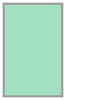

In [ ]:
display(df['geometry'][0])
print(gdf['geometry'][0])
display(gdf['geometry'][1])

In [ ]:
'''
Set the Coordinate Reference System (crs) of our GeoDataFrame

Polygon CRS =  EPSG:4326, A coordinate reference system defines a specific map projection, 
as well as transformations between different spatial reference systems. 
So basically by defining our crs we are able to accurately plot our polygons on a map.

'''
gdf.crs = 'EPSG:4326'
gdf.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [ ]:
#gdf.to_file(output_csv_path/"global_geodataframe.gpkg", driver="GPKG")

## Example with sample

In [ ]:
# Take a sample from train_final
sample_image_id = 'L15-0595E-1278N_2383_3079_13'
# find match from id
sample_gdf = gdf[gdf['file_id'] == sample_image_id].copy()
# Each id represents an image and the count, the number of buildings
sample_gdf['id'].value_counts()

2047    25
1226    25
1450    25
1418    25
1386    25
        ..
2547     3
2549     2
2550     2
2552     1
2551     1
Name: id, Length: 2553, dtype: int64

In [ ]:
#sample_gdf.to_file(output_csv_path/"sample_geodataframe.gpkg", driver="GPKG")

# [Directory Metadata Extraction](https://www.kaggle.com/amerii/spacenet-7-directory-metadata-extraction)

In [ ]:
import pandas as pd 
import re
from pathlib import Path
import shapely
import geopandas as gpd
import matplotlib as mpl
import matplotlib.pyplot as plt
from tqdm.notebook import tqdm
from glob import glob
tqdm.pandas()

In [ ]:
# Load split over training data
train_dir = Path('/content/drive/MyDrive/Colab Notebooks/SPACENET7/DATASET/dataset_pruebas/train')
test_dir = Path('/content/drive/MyDrive/Colab Notebooks/SPACENET7/DATASET/dataset_pruebas/validation')
sample_dir = Path('/content/drive/MyDrive/Colab Notebooks/SPACENET7/DATASET/SN7_buildings_train_sample')

In [ ]:
output_path = Path.cwd()
output_csv_path = output_path/'output_csvs/'
Path(output_csv_path).mkdir(parents=True, exist_ok=True)

In [ ]:
def extract_list_of_paths(directory):
    paths_list = [path for path in Path.glob(directory,pattern = '**/*.*')]
    return paths_list

train_paths = extract_list_of_paths(directory=train_dir)
test_paths = extract_list_of_paths(directory=test_dir)
sample_paths = extract_list_of_paths(directory=sample_dir)

In [ ]:
train_paths

[PosixPath('/content/drive/MyDrive/Colab Notebooks/SPACENET7/DATASET/dataset_pruebas/train/L15-0358E-1220N_1433_3310_13/images/global_monthly_2018_02_mosaic_L15-0358E-1220N_1433_3310_13.tif'),
 PosixPath('/content/drive/MyDrive/Colab Notebooks/SPACENET7/DATASET/dataset_pruebas/train/L15-0358E-1220N_1433_3310_13/images/global_monthly_2018_03_mosaic_L15-0358E-1220N_1433_3310_13.tif'),
 PosixPath('/content/drive/MyDrive/Colab Notebooks/SPACENET7/DATASET/dataset_pruebas/train/L15-0358E-1220N_1433_3310_13/images/global_monthly_2018_04_mosaic_L15-0358E-1220N_1433_3310_13.tif'),
 PosixPath('/content/drive/MyDrive/Colab Notebooks/SPACENET7/DATASET/dataset_pruebas/train/L15-0358E-1220N_1433_3310_13/images/global_monthly_2018_07_mosaic_L15-0358E-1220N_1433_3310_13.tif'),
 PosixPath('/content/drive/MyDrive/Colab Notebooks/SPACENET7/DATASET/dataset_pruebas/train/L15-0358E-1220N_1433_3310_13/images/global_monthly_2018_05_mosaic_L15-0358E-1220N_1433_3310_13.tif'),
 PosixPath('/content/drive/MyDrive/

In [ ]:
test_paths

[PosixPath('/content/drive/MyDrive/Colab Notebooks/SPACENET7/DATASET/dataset_pruebas/validation/L15-0387E-1276N_1549_3087_13/labels/global_monthly_2018_04_mosaic_L15-0387E-1276N_1549_3087_13_Buildings.geojson'),
 PosixPath('/content/drive/MyDrive/Colab Notebooks/SPACENET7/DATASET/dataset_pruebas/validation/L15-0387E-1276N_1549_3087_13/labels/global_monthly_2019_06_mosaic_L15-0387E-1276N_1549_3087_13_UDM.geojson'),
 PosixPath('/content/drive/MyDrive/Colab Notebooks/SPACENET7/DATASET/dataset_pruebas/validation/L15-0387E-1276N_1549_3087_13/labels/global_monthly_2019_07_mosaic_L15-0387E-1276N_1549_3087_13_Buildings.geojson'),
 PosixPath('/content/drive/MyDrive/Colab Notebooks/SPACENET7/DATASET/dataset_pruebas/validation/L15-0387E-1276N_1549_3087_13/labels/global_monthly_2018_03_mosaic_L15-0387E-1276N_1549_3087_13_UDM.geojson'),
 PosixPath('/content/drive/MyDrive/Colab Notebooks/SPACENET7/DATASET/dataset_pruebas/validation/L15-0387E-1276N_1549_3087_13/labels/global_monthly_2019_08_mosaic_L1

In [ ]:
def extract_metadata_from_string(string):
    # extracted groups
    # full path - image_dir_name - sub_dir_name - fname - year - month - data_type - extension
    pattern = r'/(t.+|v.+|sample+)/(L.+)/(\w+)/(.+_(\d+)_(\d+)_m.+_\d+_\d+_\d+)(?:_(\w+))?.(\w+)'
    match = re.findall(pattern=pattern,string=string)
    #print(match)
    return match[0]

def extract_metadata_from_list_of_paths(list_of_paths):
    d_keys = ['parent_dir','image_dir_name','sub_dir_name','fname','year','month','data_type','extension']
    d = {key:[] for key in d_keys}
    d['full_path'] = []
    for path in list_of_paths:      
        metadata = extract_metadata_from_string(str(path))
        d['full_path'].append(path)
        
        for i,data in enumerate(metadata):
            d[d_keys[i]].append(data)
    return d

train_metadata_dict = extract_metadata_from_list_of_paths(train_paths)
test_metadata_dict = extract_metadata_from_list_of_paths(test_paths)
sample_metadata_dict = extract_metadata_from_list_of_paths(sample_paths)

In [ ]:
df_train = pd.DataFrame(train_metadata_dict)
df_test = pd.DataFrame(test_metadata_dict)
df_sample = pd.DataFrame(sample_metadata_dict)

In [ ]:
df_train

,parent_dir,image_dir_name,sub_dir_name,fname,year,month,data_type,extension,full_path
0,train,L15-0358E-1220N_1433_3310_13,images,global_monthly_2018_02_mosaic_L15-0358E-1220N_...,2018,02,,tif,/content/drive/MyDrive/Colab Notebooks/SPACENE...
1,train,L15-0358E-1220N_1433_3310_13,images,global_monthly_2018_03_mosaic_L15-0358E-1220N_...,2018,03,,tif,/content/drive/MyDrive/Colab Notebooks/SPACENE...
2,train,L15-0358E-1220N_1433_3310_13,images,global_monthly_2018_04_mosaic_L15-0358E-1220N_...,2018,04,,tif,/content/drive/MyDrive/Colab Notebooks/SPACENE...
3,train,L15-0358E-1220N_1433_3310_13,images,global_monthly_2018_07_mosaic_L15-0358E-1220N_...,2018,07,,tif,/content/drive/MyDrive/Colab Notebooks/SPACENE...
4,train,L15-0358E-1220N_1433_3310_13,images,global_monthly_2018_05_mosaic_L15-0358E-1220N_...,2018,05,,tif,/content/drive/MyDrive/Colab Notebooks/SPACENE...
...,...,...,...,...,...,...,...,...,...
580,train,L15-0368E-1245N_1474_3210_13,images,global_monthly_2019_09_mosaic_L15-0368E-1245N_...,2019,09,,tif,/content/drive/MyDrive/Colab Notebooks/SPACENE...
581,train,L15-0368E-1245N_1474_3210_13,images,global_monthly_2019_10_mosaic_L15-0368E-1245N_...,2019,10,,tif,/content/drive/MyDrive/Colab Notebooks/SPACENE...
582,train,L15-0368E-1245N_1474_3210_13,images,global_monthly_2020_01_mosaic_L15-0368E-1245N_...,2020,01,,tif,/content/drive/MyDrive/Colab Notebooks/SPACENE...
583,train,L15-0368E-1245N_1474_3210_13,images,global_monthly_2019_11_mosaic_L15-0368E-1245N_...,2019,11,,tif,/content/drive/MyDrive/Colab Notebooks/SPACENE...


In [ ]:
df_train[df_train['data_type'] == 'Buildings']['extension'].value_counts()

geojson    291
Name: extension, dtype: int64

In [ ]:
df_train[df_train['data_type'] == 'UDM']['extension'].value_counts()

geojson    97
tif         3
Name: extension, dtype: int64

In [ ]:
df_train[df_train['data_type'] == '']['extension'].value_counts()

tif    194
Name: extension, dtype: int64

In [ ]:
df_train.loc[df_train['data_type'] =='','data_type'] = 'Images'
df_test.loc[df_test['data_type'] =='','data_type'] = 'Images'
df_sample.loc[df_sample['data_type'] =='','data_type'] = 'Images'

In [ ]:
df_train.groupby(["data_type"]).count()

,parent_dir,image_dir_name,sub_dir_name,fname,year,month,extension,full_path
data_type,,,,,,,,
Buildings,291,291,291,291,291,291,291,291
Images,194,194,194,194,194,194,194,194
UDM,100,100,100,100,100,100,100,100


In [ ]:
def get_metadata(input_dir):
    list_of_paths = extract_list_of_paths(input_dir)
    metadata_dict = extract_metadata_from_list_of_paths(list_of_paths)
    df = pd.DataFrame(metadata_dict)
    
    df.loc[df['data_type'] =='','data_type'] = 'Images'
    

    # Identify Images that have UDM Masks
    condition = (df['sub_dir_name'] == 'UDM_masks')
    # Get the indices of the images that have udm
    udm_indices = df.loc[condition].index
    # Get list of unique file names that have UDMs
    udm_fnames = list(df.loc[udm_indices,'fname'])
    # Get all rows that match the file names
    udm_mask = df['fname'].progress_map(lambda x: x in udm_fnames)
    # Initialize has_udm column 
    df['has_udm'] = False
    # Apply mask and update udm value
    df.loc[udm_mask,'has_udm'] = True

    return df

In [ ]:
df_train = get_metadata(train_dir)
df_test = get_metadata(test_dir)
df_sample = get_metadata(sample_dir)
df_concat = pd.concat([df_train,df_test,df_sample]).reset_index()

  0%|          | 0/585 [00:00<?, ?it/s]

  0%|          | 0/433 [00:00<?, ?it/s]

  0%|          | 0/146 [00:00<?, ?it/s]

In [ ]:
df_train

,parent_dir,image_dir_name,sub_dir_name,fname,year,month,data_type,extension,full_path,has_udm
0,train,L15-0358E-1220N_1433_3310_13,images,global_monthly_2018_02_mosaic_L15-0358E-1220N_...,2018,02,Images,tif,/content/drive/MyDrive/Colab Notebooks/SPACENE...,False
1,train,L15-0358E-1220N_1433_3310_13,images,global_monthly_2018_03_mosaic_L15-0358E-1220N_...,2018,03,Images,tif,/content/drive/MyDrive/Colab Notebooks/SPACENE...,False
2,train,L15-0358E-1220N_1433_3310_13,images,global_monthly_2018_04_mosaic_L15-0358E-1220N_...,2018,04,Images,tif,/content/drive/MyDrive/Colab Notebooks/SPACENE...,False
3,train,L15-0358E-1220N_1433_3310_13,images,global_monthly_2018_07_mosaic_L15-0358E-1220N_...,2018,07,Images,tif,/content/drive/MyDrive/Colab Notebooks/SPACENE...,False
4,train,L15-0358E-1220N_1433_3310_13,images,global_monthly_2018_05_mosaic_L15-0358E-1220N_...,2018,05,Images,tif,/content/drive/MyDrive/Colab Notebooks/SPACENE...,True
...,...,...,...,...,...,...,...,...,...,...
580,train,L15-0368E-1245N_1474_3210_13,images,global_monthly_2019_09_mosaic_L15-0368E-1245N_...,2019,09,Images,tif,/content/drive/MyDrive/Colab Notebooks/SPACENE...,False
581,train,L15-0368E-1245N_1474_3210_13,images,global_monthly_2019_10_mosaic_L15-0368E-1245N_...,2019,10,Images,tif,/content/drive/MyDrive/Colab Notebooks/SPACENE...,False
582,train,L15-0368E-1245N_1474_3210_13,images,global_monthly_2020_01_mosaic_L15-0368E-1245N_...,2020,01,Images,tif,/content/drive/MyDrive/Colab Notebooks/SPACENE...,False
583,train,L15-0368E-1245N_1474_3210_13,images,global_monthly_2019_11_mosaic_L15-0368E-1245N_...,2019,11,Images,tif,/content/drive/MyDrive/Colab Notebooks/SPACENE...,False


In [ ]:
df_train.to_csv(output_csv_path/'df_train.csv',index=False)
df_test.to_csv(output_csv_path/'df_test.csv',index=False)
df_sample.to_csv(output_csv_path/'df_sample.csv',index=False)
df_concat.to_csv(output_csv_path/'df_concat.csv',index=False)

In [ ]:
df_train.head()
df_train.columns
df_train.info()
df_train[:4]

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 585 entries, 0 to 584
Data columns (total 10 columns):
 #   Column          Non-Null Count  Dtype 
---  ------          --------------  ----- 
 0   parent_dir      585 non-null    object
 1   image_dir_name  585 non-null    object
 2   sub_dir_name    585 non-null    object
 3   fname           585 non-null    object
 4   year            585 non-null    object
 5   month           585 non-null    object
 6   data_type       585 non-null    object
 7   extension       585 non-null    object
 8   full_path       585 non-null    object
 9   has_udm         585 non-null    bool  
dtypes: bool(1), object(9)
memory usage: 41.8+ KB


,parent_dir,image_dir_name,sub_dir_name,fname,year,month,data_type,extension,full_path,has_udm
0,train,L15-0358E-1220N_1433_3310_13,images,global_monthly_2018_02_mosaic_L15-0358E-1220N_...,2018,02,Images,tif,/content/drive/MyDrive/Colab Notebooks/SPACENE...,False
1,train,L15-0358E-1220N_1433_3310_13,images,global_monthly_2018_03_mosaic_L15-0358E-1220N_...,2018,03,Images,tif,/content/drive/MyDrive/Colab Notebooks/SPACENE...,False
2,train,L15-0358E-1220N_1433_3310_13,images,global_monthly_2018_04_mosaic_L15-0358E-1220N_...,2018,04,Images,tif,/content/drive/MyDrive/Colab Notebooks/SPACENE...,False
3,train,L15-0358E-1220N_1433_3310_13,images,global_monthly_2018_07_mosaic_L15-0358E-1220N_...,2018,07,Images,tif,/content/drive/MyDrive/Colab Notebooks/SPACENE...,False


In [ ]:
!ls ./output_csvs

df_concat.csv	      df_test.csv	   global_geodataframe.gpkg
df_concat_untidy.csv  df_test_untidy.csv   sample_geodataframe.gpkg
df_sample.csv	      df_train.csv
df_sample_untidy.csv  df_train_untidy.csv


# Fit all data into single CSV files 

In [ ]:
'''
OUTPUT: Convert DF to dictionary,  asign None values for UDM masks
'''
def untidy_df(df):
    
    parent_dir = df['parent_dir']
    im_dir_name = df['image_dir_name']
    fname = df['fname']
    year = df['year']
    month = df['month']
    has_udm = df['has_udm']
    
    images_masked = im_dir_name + '/images_masked/' + fname + '.tif'
    
    if parent_dir == 'validation':
            images = None
            labels_buildings = None
            labels_udm = None
            labels_match = None
            labels_match_pix = None
            udm_masks = None
    else:
        if has_udm:
            udm_masks = im_dir_name + '/UDM_masks/' + fname + '.tif'
        else:
            udm_masks = None


        images = im_dir_name + '/images/' + fname + '.tif'
        labels_buildings = im_dir_name + '/labels/' + fname + '_Buildings.geojson'
        labels_udm = im_dir_name + '/labels/' + fname + '_UDM.geojson'
        labels_match = im_dir_name + '/labels_match/' + fname + '_Buildings.geojson'
        labels_match_pix = im_dir_name + '/labels_match_pix/' + fname + '_Buildings.geojson'

    keys = ['parent_dir','image_dir_name','fname','year','month','has_udm','udm_masks','images','images_masked','labels_buildings','labels_udm','labels_match','labels_match_pix']
    values = [parent_dir,im_dir_name,fname,year,month,has_udm,udm_masks,images,images_masked,labels_buildings,labels_udm,labels_match,labels_match_pix]
    
    return {k:v for (k,v) in zip(keys,values)}

def get_untidy_frame(df):
    # apply function on input dataframe
    list_of_dicts = df.progress_apply(lambda x: untidy_df(x), axis=1)
    # drop the duplicated columns
    untidy_frame = pd.DataFrame.from_records(list_of_dicts).drop_duplicates()
    # bask in all the glory of your untidy frame ;D
    return untidy_frame

test_untidy_df = get_untidy_frame(df_test)
train_untidy_df = get_untidy_frame(df_train)
sample_untidy_df = get_untidy_frame(df_sample)
concat_untidy_df = get_untidy_frame(df_concat)

  0%|          | 0/433 [00:00<?, ?it/s]

  0%|          | 0/585 [00:00<?, ?it/s]

  0%|          | 0/146 [00:00<?, ?it/s]

  0%|          | 0/1164 [00:00<?, ?it/s]

In [ ]:
test_untidy_df.groupby(["labels_match_pix"]).count()
concat_untidy_df

,parent_dir,image_dir_name,fname,year,month,has_udm,udm_masks,images,images_masked,labels_buildings,labels_udm,labels_match,labels_match_pix
0,train,L15-0358E-1220N_1433_3310_13,global_monthly_2018_02_mosaic_L15-0358E-1220N_...,2018,02,False,None,L15-0358E-1220N_1433_3310_13/images/global_mon...,L15-0358E-1220N_1433_3310_13/images_masked/glo...,L15-0358E-1220N_1433_3310_13/labels/global_mon...,L15-0358E-1220N_1433_3310_13/labels/global_mon...,L15-0358E-1220N_1433_3310_13/labels_match/glob...,L15-0358E-1220N_1433_3310_13/labels_match_pix/...
1,train,L15-0358E-1220N_1433_3310_13,global_monthly_2018_03_mosaic_L15-0358E-1220N_...,2018,03,False,None,L15-0358E-1220N_1433_3310_13/images/global_mon...,L15-0358E-1220N_1433_3310_13/images_masked/glo...,L15-0358E-1220N_1433_3310_13/labels/global_mon...,L15-0358E-1220N_1433_3310_13/labels/global_mon...,L15-0358E-1220N_1433_3310_13/labels_match/glob...,L15-0358E-1220N_1433_3310_13/labels_match_pix/...
2,train,L15-0358E-1220N_1433_3310_13,global_monthly_2018_04_mosaic_L15-0358E-1220N_...,2018,04,False,None,L15-0358E-1220N_1433_3310_13/images/global_mon...,L15-0358E-1220N_1433_3310_13/images_masked/glo...,L15-0358E-1220N_1433_3310_13/labels/global_mon...,L15-0358E-1220N_1433_3310_13/labels/global_mon...,L15-0358E-1220N_1433_3310_13/labels_match/glob...,L15-0358E-1220N_1433_3310_13/labels_match_pix/...
3,train,L15-0358E-1220N_1433_3310_13,global_monthly_2018_07_mosaic_L15-0358E-1220N_...,2018,07,False,None,L15-0358E-1220N_1433_3310_13/images/global_mon...,L15-0358E-1220N_1433_3310_13/images_masked/glo...,L15-0358E-1220N_1433_3310_13/labels/global_mon...,L15-0358E-1220N_1433_3310_13/labels/global_mon...,L15-0358E-1220N_1433_3310_13/labels_match/glob...,L15-0358E-1220N_1433_3310_13/labels_match_pix/...
4,train,L15-0358E-1220N_1433_3310_13,global_monthly_2018_05_mosaic_L15-0358E-1220N_...,2018,05,True,L15-0358E-1220N_1433_3310_13/UDM_masks/global_...,L15-0358E-1220N_1433_3310_13/images/global_mon...,L15-0358E-1220N_1433_3310_13/images_masked/glo...,L15-0358E-1220N_1433_3310_13/labels/global_mon...,L15-0358E-1220N_1433_3310_13/labels/global_mon...,L15-0358E-1220N_1433_3310_13/labels_match/glob...,L15-0358E-1220N_1433_3310_13/labels_match_pix/...
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1037,sample,L15-0506E-1204N_2027_3374_13,global_monthly_2019_08_mosaic_L15-0506E-1204N_...,2019,08,False,None,L15-0506E-1204N_2027_3374_13/images/global_mon...,L15-0506E-1204N_2027_3374_13/images_masked/glo...,L15-0506E-1204N_2027_3374_13/labels/global_mon...,L15-0506E-1204N_2027_3374_13/labels/global_mon...,L15-0506E-1204N_2027_3374_13/labels_match/glob...,L15-0506E-1204N_2027_3374_13/labels_match_pix/...
1038,sample,L15-0506E-1204N_2027_3374_13,global_monthly_2019_11_mosaic_L15-0506E-1204N_...,2019,11,True,L15-0506E-1204N_2027_3374_13/UDM_masks/global_...,L15-0506E-1204N_2027_3374_13/images/global_mon...,L15-0506E-1204N_2027_3374_13/images_masked/glo...,L15-0506E-1204N_2027_3374_13/labels/global_mon...,L15-0506E-1204N_2027_3374_13/labels/global_mon...,L15-0506E-1204N_2027_3374_13/labels_match/glob...,L15-0506E-1204N_2027_3374_13/labels_match_pix/...
1039,sample,L15-0506E-1204N_2027_3374_13,global_monthly_2019_09_mosaic_L15-0506E-1204N_...,2019,09,False,None,L15-0506E-1204N_2027_3374_13/images/global_mon...,L15-0506E-1204N_2027_3374_13/images_masked/glo...,L15-0506E-1204N_2027_3374_13/labels/global_mon...,L15-0506E-1204N_2027_3374_13/labels/global_mon...,L15-0506E-1204N_2027_3374_13/labels_match/glob...,L15-0506E-1204N_2027_3374_13/labels_match_pix/...
1040,sample,L15-0506E-1204N_2027_3374_13,global_monthly_2019_10_mosaic_L15-0506E-1204N_...,2019,10,False,None,L15-0506E-1204N_2027_3374_13/images/global_mon...,L15-0506E-1204N_2027_3374_13/images_masked/glo...,L15-0506E-1204N_2027_3374_13/labels/global_mon...,L15-0506E-1204N_2027_3374_13/labels/global_mon...,L15-0506E-1204N_2027_3374_13/labels_match/glob...,L15-0506E-1204N_2027_3374_13/labels_match_pix/...


In [ ]:
train_untidy_df.to_csv(output_csv_path/'df_train_untidy.csv',index=False)
test_untidy_df.to_csv(output_csv_path/'df_test_untidy.csv',index=False)
sample_untidy_df.to_csv(output_csv_path/'df_sample_untidy.csv',index=False)
concat_untidy_df.to_csv(output_csv_path/'df_concat_untidy.csv',index=False)

In [ ]:
!ls ./output_csvs

df_concat.csv	      df_test.csv	   global_geodataframe.gpkg
df_concat_untidy.csv  df_test_untidy.csv   sample_geodataframe.gpkg
df_sample.csv	      df_train.csv
df_sample_untidy.csv  df_train_untidy.csv


# Pytorch class functions for dataset

In [ ]:
from __future__ import print_function, division
import os
import torch
import pandas as pd
from skimage import io, transform
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
import rasterio as rio
from rasterio import features
from pathlib import Path
import pathlib
import geopandas as gpd
from descartes import PolygonPatch
from PIL import Image
import itertools
import re
from tqdm.notebook import tqdm

from torch.utils.data import Dataset, DataLoader
from torchvision import transforms, utils

import imgaug
import random


# Ignore warnings
import warnings
warnings.filterwarnings("ignore")

plt.ion()   # interactive mode

%matplotlib inline

mpl.rcParams['figure.dpi'] = 300 #increase plot resolution
mpl.rcParams['figure.dpi']

300.0

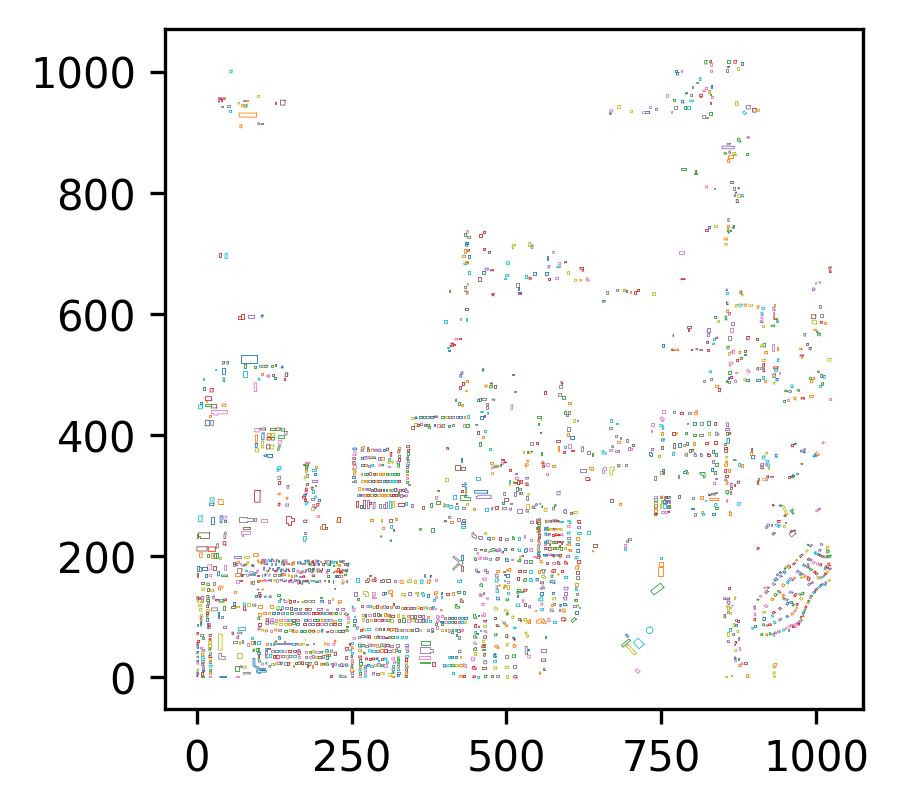

In [ ]:
test_raster_path = Path('/content/drive/MyDrive/Colab Notebooks/SPACENET7/DATASET/SN7_buildings_train_sample/sample/L15-0506E-1204N_2027_3374_13/images/global_monthly_2018_01_mosaic_L15-0506E-1204N_2027_3374_13.tif')
test_raster_path_24 = Path('/content/drive/MyDrive/Colab Notebooks/SPACENET7/DATASET/SN7_buildings_train_sample/sample/L15-0506E-1204N_2027_3374_13/images/global_monthly_2019_12_mosaic_L15-0506E-1204N_2027_3374_13.tif')
test_geojson_path = Path('/content/drive/MyDrive/Colab Notebooks/SPACENET7/DATASET/SN7_buildings_train_sample/sample/L15-0506E-1204N_2027_3374_13/labels_match_pix/global_monthly_2018_01_mosaic_L15-0506E-1204N_2027_3374_13_Buildings.geojson')
test_geojson_path_24 = Path('/content/drive/MyDrive/Colab Notebooks/SPACENET7/DATASET/SN7_buildings_train_sample/sample/L15-0506E-1204N_2027_3374_13/labels_match_pix/global_monthly_2019_12_mosaic_L15-0506E-1204N_2027_3374_13_Buildings.geojson')
test_gdf = gpd.read_file(test_geojson_path)
test_gdf_24 = gpd.read_file(test_geojson_path_24)

test_gdf.set_index('Id',inplace=True)
test_gdf_24.set_index('Id',inplace=True)

test_gdf.sort_index(inplace=True)
test_gdf_24.sort_index(inplace=True)

def plot_gdf(gdf,fill=False,ax=None,linewidth=0.2):
    if ax is None:
        _,ax = plt.subplots(1,figsize=(3, 3))
        
    for geom in gdf['geometry']:
        if fill:
            patch = PolygonPatch(geom,linewidth=linewidth,color='fuchsia')
            ax.add_patch(patch)
        else:
            ax.plot(*geom.exterior.xy,linewidth=linewidth)
    return(ax)

plot_gdf(test_gdf);

In [ ]:
test_gdf

,area,image_fname,geometry
Id,,,
0,7797.403072,global_monthly_2018_01_mosaic_L15-0506E-1204N_...,"POLYGON ((96.76069 532.75017, 70.39820 532.750..."
1,4199.716038,global_monthly_2018_01_mosaic_L15-0506E-1204N_...,"POLYGON ((96.47195 931.55128, 68.33719 931.772..."
2,4087.709099,global_monthly_2018_01_mosaic_L15-0506E-1204N_...,"POLYGON ((754.33064 148.41324, 748.97152 155.4..."
3,3942.940783,global_monthly_2018_01_mosaic_L15-0506E-1204N_...,"POLYGON ((102.03172 308.69945, 93.17003 308.74..."
4,3878.821424,global_monthly_2018_01_mosaic_L15-0506E-1204N_...,"POLYGON ((376.01265 40.56842, 376.01265 42.119..."
...,...,...,...
2268,34.022245,global_monthly_2018_01_mosaic_L15-0506E-1204N_...,"POLYGON ((175.10411 63.00523, 174.10721 63.005..."
2269,33.689724,global_monthly_2018_01_mosaic_L15-0506E-1204N_...,"POLYGON ((180.23907 157.06562, 179.26986 157.0..."
2270,29.751964,global_monthly_2018_01_mosaic_L15-0506E-1204N_...,"POLYGON ((118.17847 179.68358, 118.04001 181.2..."


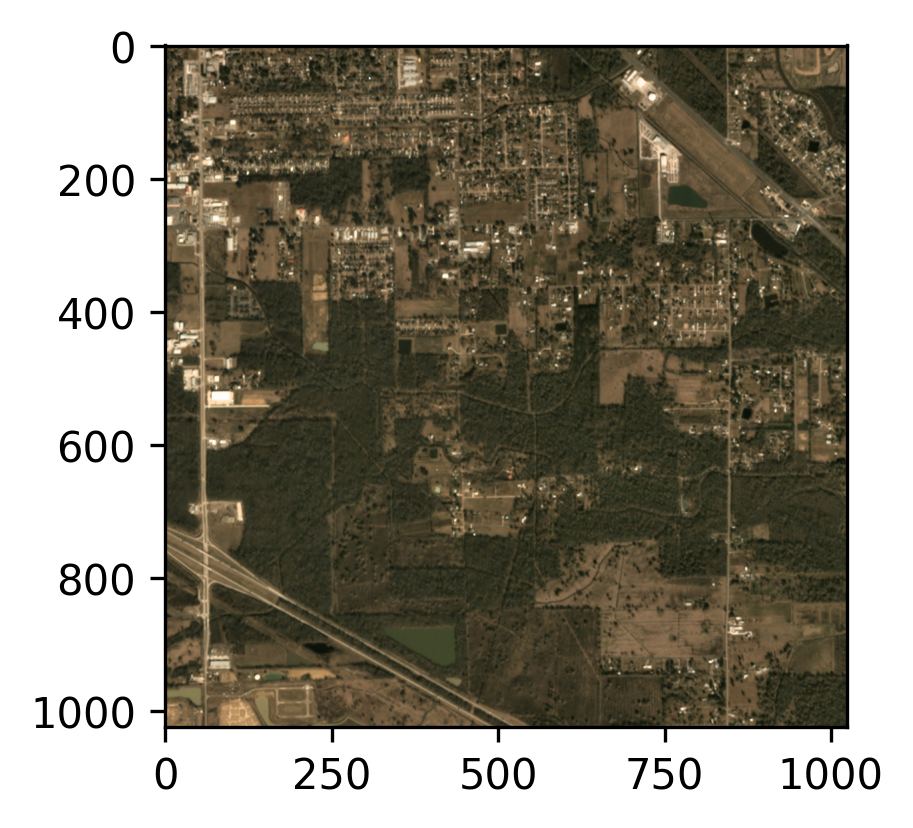

In [ ]:
def plot_sat(path,gdf=None, fill=False,linewidth=0.2):
    f, ax = plt.subplots(1,figsize=(3, 3))
    f.tight_layout()
    
    r = rio.open(path)
    r = r.read()
    r = r.transpose((1,2,0,))
    ax.imshow(r)
    
    if gdf is not None:
        plot_gdf(gdf,fill=fill,ax=ax,linewidth=linewidth)
        
    return(ax)

plot_sat(path=test_raster_path)

In [ ]:
r = rio.open(test_raster_path)
r = r.read()

r.shape

(4, 1024, 1024)

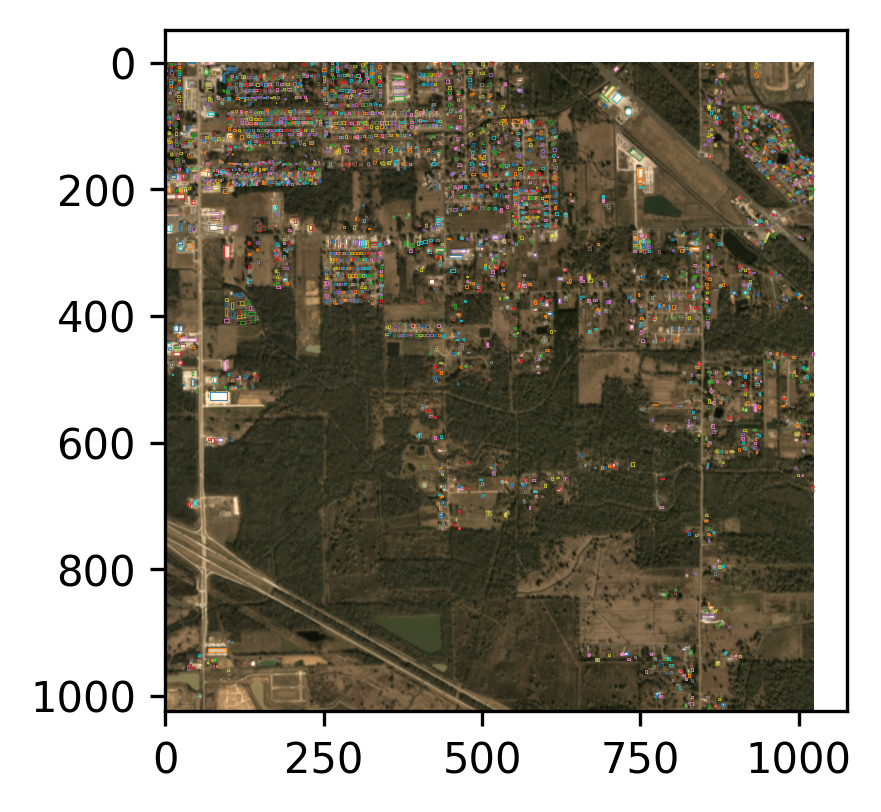

In [ ]:
plot_sat(path=test_raster_path,gdf=test_gdf);

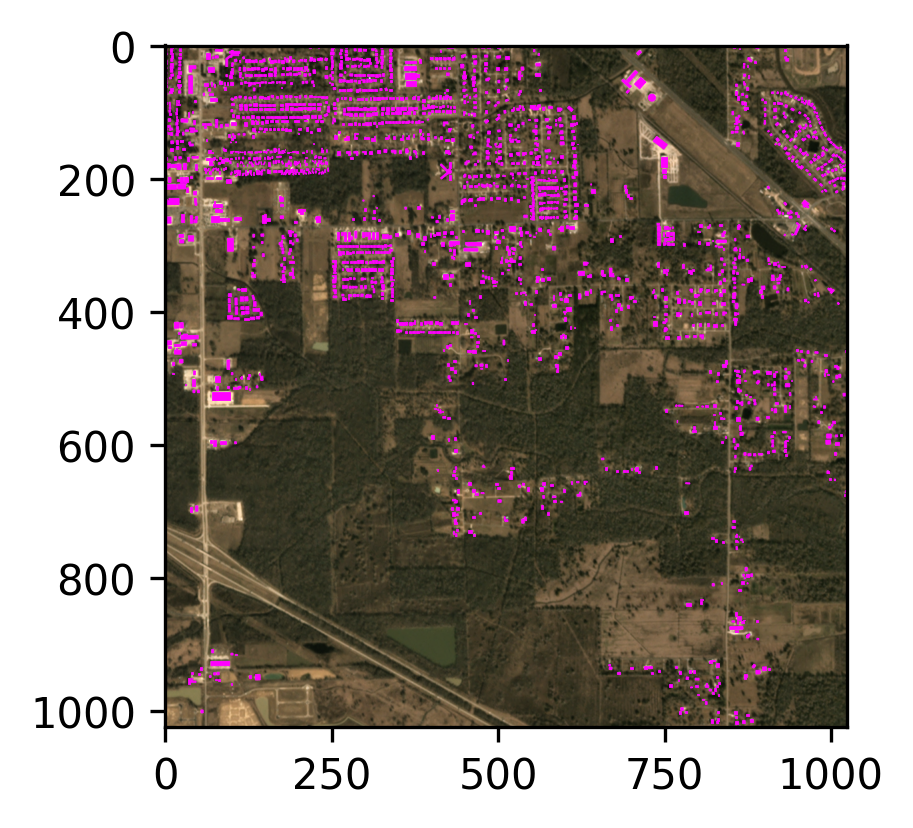

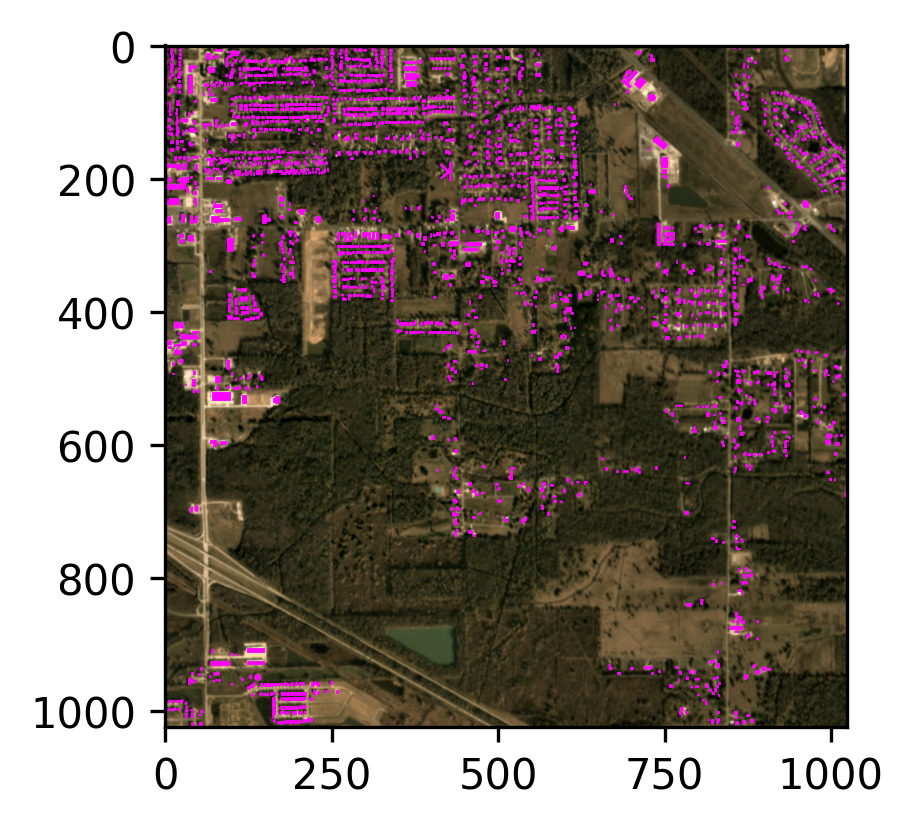

In [ ]:
plot_sat(path=test_raster_path,gdf=test_gdf,fill=True);
plot_sat(path=test_raster_path_24,gdf=test_gdf_24,fill=True);

### Rasterize image 
Convert GeoJSON files stored in Labels and create Masks (containg 1 and 0 s)

In [ ]:
def rasterize_geojson(geojson_path,reference_raster_path):
    gdf = gpd.read_file(geojson_path)
    with rio.open(reference_raster_path) as raster:
        r = raster.read(1)
        
        mask = image = features.rasterize(((polygon, 255) for polygon in gdf['geometry']),out_shape=r.shape)
        
    return mask

def rasterize_gdf(gdf,reference_raster_path):
    
    with rio.open(reference_raster_path) as raster:
        r = raster.read(1)
        
        mask = image = features.rasterize(((polygon, 255) for polygon in gdf['geometry']),out_shape=r.shape)
        
    return mask

[  0 255]
(1024, 1024)


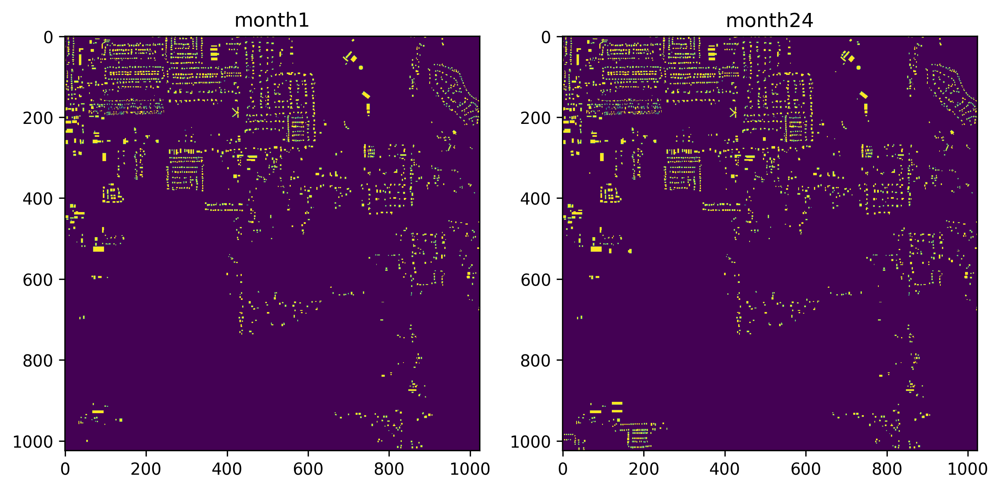

In [ ]:
test_mask = rasterize_geojson(test_geojson_path,test_raster_path)
test_mask_24 = rasterize_geojson(test_geojson_path_24,test_raster_path_24)

print(np.unique(test_mask))
print(test_mask_24.shape)

mpl.rcParams['figure.dpi'] = 300
_,axs = plt.subplots(1,2,figsize=(10,10))

masks = [test_mask,test_mask_24]
titles = ['month1','month24']

for i,ax in enumerate(axs):
    ax.set_title(titles[i])
    ax.imshow(masks[i]);

In [ ]:
def gdf_difference(gdf1, gdf2, get_dates=False):
    try:
        gdf1.reset_index(inplace=True,drop=True)
    except:
        pass
    try:
        gdf2.reset_index(inplace=True,drop=True)
    except:
        pass
    
    
    len_1 = len(gdf1)
    len_2 = len(gdf2)
    
    len_diff = abs(len_2-len_1)
    
    if len_2 > len_1:
        start_index = len_2-len_diff
        diff_gdf = gdf2[start_index:].copy()
    else:
        start_index = len_1-len_diff
        diff_gdf = gdf1[start_index:].copy()

    diff_gdf.reset_index(inplace=True,drop=True)
        
    return diff_gdf
len(test_gdf)

diff_gdf = gdf_difference(test_gdf,test_gdf_24)
print(f"New buildings: {len(diff_gdf)}")
diff_gdf.head(10)

# Rasterize - convert new GEOJSON buildings to mask
test_mask_diff = rasterize_gdf(diff_gdf,test_raster_path)

New buildings: 202


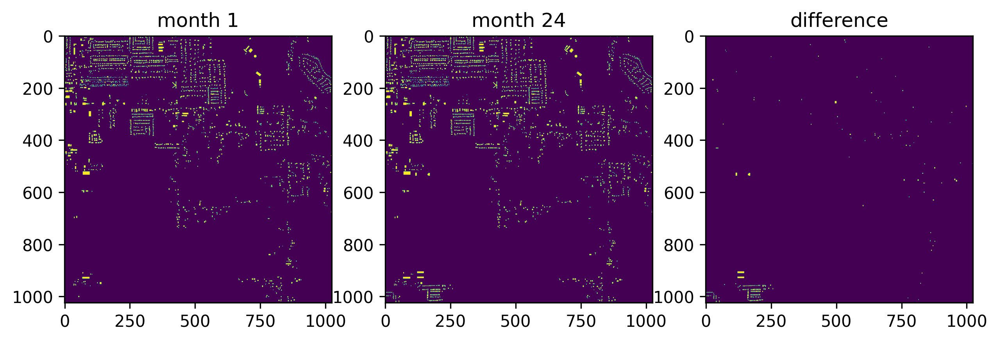

In [ ]:
mpl.rcParams['figure.dpi'] = 300
_,axs = plt.subplots(1,3,figsize=(10,10))

masks = [test_mask,test_mask_24,test_mask_diff]
titles = ['month 1', 'month 24', 'difference']

for i,ax in enumerate(axs):
    ax.set_title(titles[i])
    ax.imshow(masks[i]);

In [ ]:
 zeros = np.zeros([1024, 1024])
 zeros.shape

(1024, 1024)

In [ ]:
class chip_creator():   
    def __init__(self, chip_dimension=256,raster=False):  
        self.chip_dimension = chip_dimension
        self.raster = raster
        
    def create_chips(self,image):
        np_array = self.__read_image(image)
        # get number of chips per colomn
        n_rows = (np_array.shape[0] - 1) // self.chip_dimension + 1
        # get number of chips per row
        n_cols = (np_array.shape[1] - 1) // self.chip_dimension + 1
        # segment image into chips and return list of chips
        l = []

        for r in range(n_rows):
            for c in range(n_cols):
                start_r_idx = r*self.chip_dimension
                end_r_idx = start_r_idx + self.chip_dimension

                start_c_idx = c*self.chip_dimension
                end_c_idx = start_c_idx + self.chip_dimension
                chip = np_array[start_r_idx:end_r_idx,start_c_idx:end_c_idx]
                if self.raster:
                   chip = np.moveaxis(chip,-1,0)

                l.append(chip)

        return np.array(l)
    
    def __read_image(self,image):
        # check whether image is a path or array
        if isinstance(image,(pathlib.PurePath,str)):
                with Image.open(image) as img:
                    # convert image into np array
                    np_array = np.array(img)
                return np_array
            
        elif isinstance(image,np.ndarray):
            return image
        else:
            raise ValueError(f"Expected Path or Numpy array received: {type(image)}")

In [ ]:
class chip_creator2():   
    def __init__(self, chip_dimension=256,raster=False):  
        self.chip_dimension = chip_dimension
        self.raster = raster
        
    def create_chips(self,image):
        np_array = self.__read_image(image)
        zeros = np.zeros([1024, 1024,4])
        zeros[0:np_array.shape[0], 0:np_array.shape[1],:] = np_array
        
        print(f"ADFMVVD {zeros.shape}")
        #np_array = np.resize(np_array, [1024, 1024])
        #np_array = np_array + zeros
        # get number of chips per colomn
        n_rows = (zeros.shape[0] - 1) // self.chip_dimension + 1
        print(n_rows)
        # get number of chips per row
        n_cols = (zeros.shape[1] - 1) // self.chip_dimension + 1
        # segment image into chips and return list of chips
        l = []

        for r in range(n_rows): # in terms of zeros array
            for c in range(n_cols):
                start_r_idx = r*self.chip_dimension
                end_r_idx = start_r_idx + self.chip_dimension

                start_c_idx = c*self.chip_dimension
                end_c_idx = start_c_idx + self.chip_dimension
                chip = zeros[start_r_idx:end_r_idx,start_c_idx:end_c_idx]
                if self.raster:
                   chip = np.moveaxis(chip,-1,0)
                print(chip.shape)
                l.append(chip)

        return np.array(l)
    
    def __read_image(self,image):
        # check whether image is a path or array
        if isinstance(image,(pathlib.PurePath,str)):
                with Image.open(image) as img:
                    # convert image into np array
                    np_array = np.array(img)
                return np_array
            
        elif isinstance(image,np.ndarray):
            return image
        else:
            raise ValueError(f"Expected Path or Numpy array received: {type(image)}")

In [ ]:
chips_256 = chip_creator(raster=True)

In [ ]:
chips_256.create_chips(test_raster_path)[0].shape

(4, 256, 256)

In [ ]:
chips_256.create_chips(test_raster_path).shape
new = np.transpose(chips_256.create_chips(test_raster_path), [0,2,3,1])
new.shape

(16, 256, 256, 4)

In [ ]:
def multiplot_images(list_of_images,ncols=4,dpi=300, raster=False):
    mpl.rcParams['figure.dpi'] = dpi
    nrows = (len(list_of_images) - 1) // ncols + 1
    fig,axs = plt.subplots(nrows,ncols,figsize=(10,10))
    
    fig.tight_layout()
    
    for r,ax in enumerate(axs):
        for c,row in enumerate(ax):
            # get the current index of the image
            i = r*ncols + c
            ax[c].set_title(i)
            image = list_of_images[i]
            # if the image is presented in raster format then move the channel axis
            if raster:
                image = np.moveaxis(image,0,-1)
            ax[c].imshow(image);

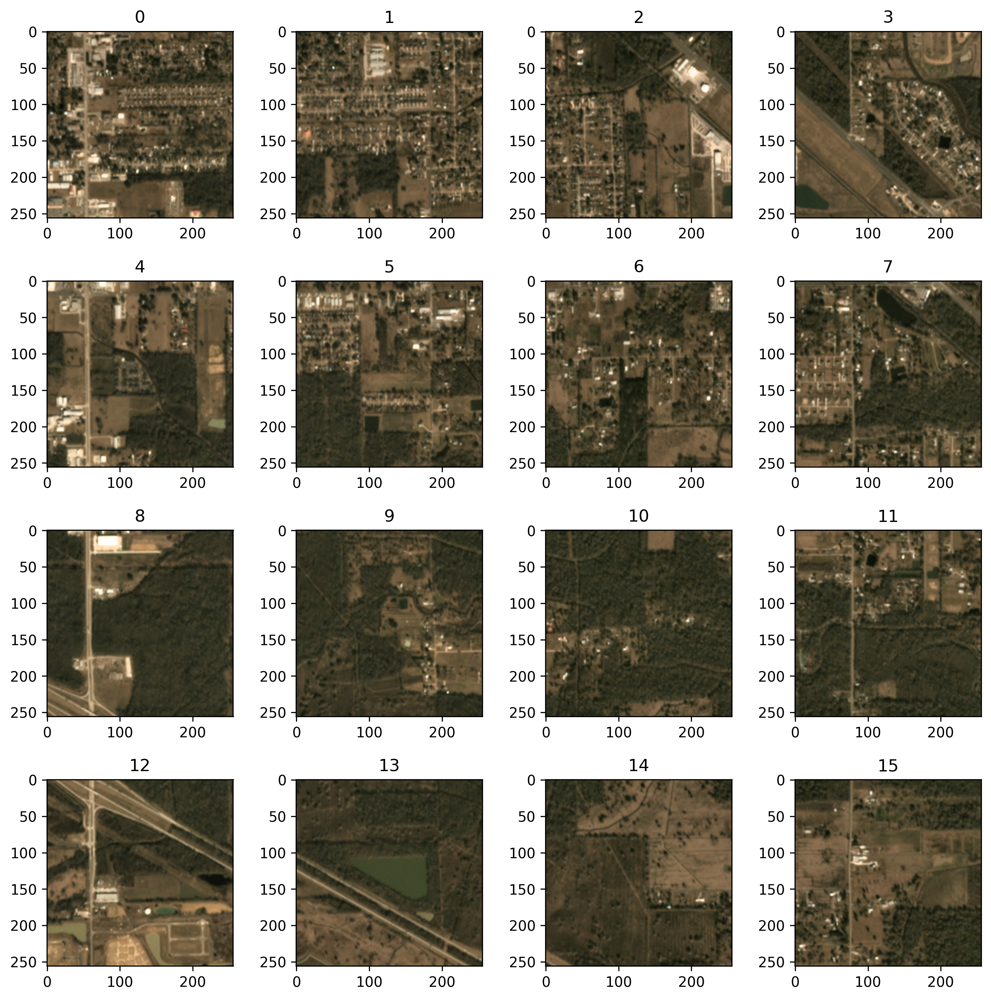

In [ ]:
multiplot_images(new);

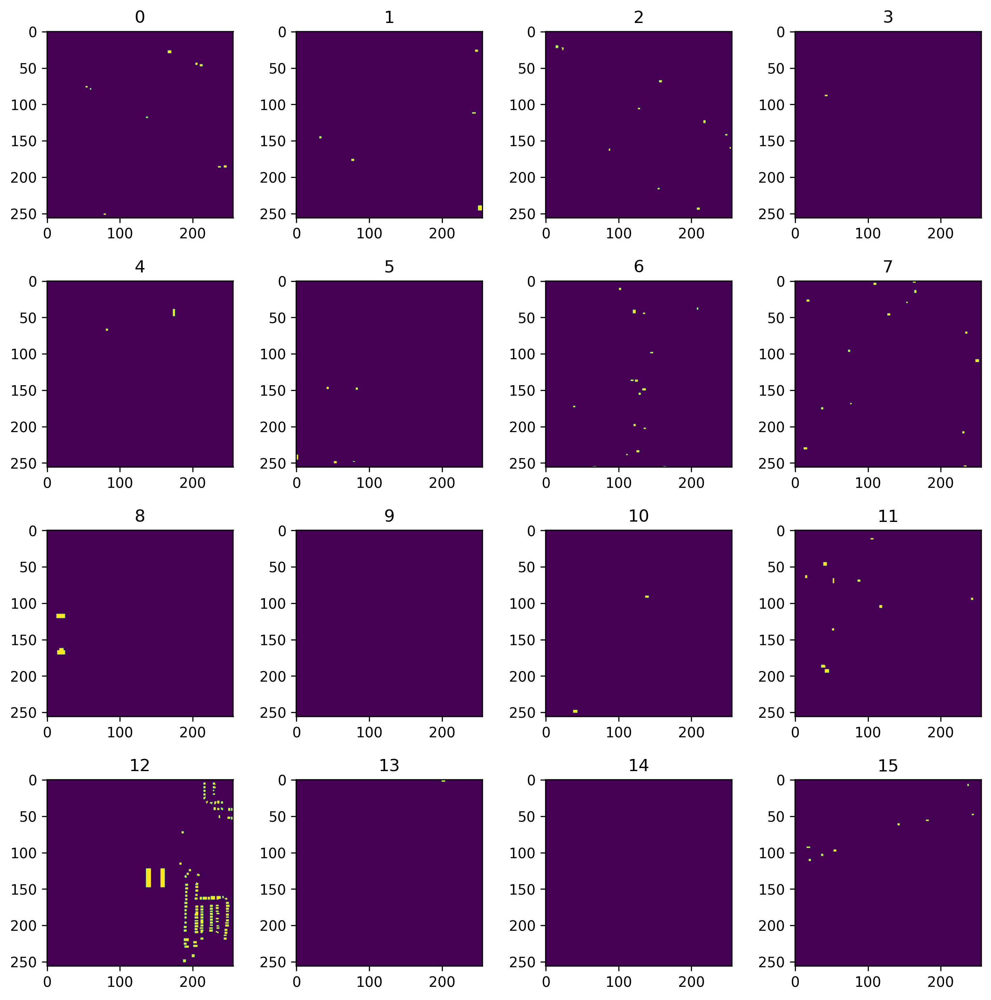

In [ ]:
multiplot_images(chips_256.create_chips(test_mask_diff));

# DATASET CLASS

In [ ]:
from __future__ import print_function, division
import os
import torch
import pandas as pd
from skimage import io, transform
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
import rasterio as rio
from rasterio import features
from pathlib import Path
import pathlib
import geopandas as gpd
from descartes import PolygonPatch
from PIL import Image
import itertools
import re
from tqdm.notebook import tqdm

from torch.utils.data import Dataset, DataLoader
from torchvision import transforms, utils

import imgaug
import random
# Ignore warnings
import warnings
warnings.filterwarnings("ignore")

plt.ion()   # interactive mode

%matplotlib inline

In [ ]:
im_path = Path('/content/drive/MyDrive/Colab Notebooks/SPACENET7/DATASET/SN7_buildings_train_sample/sample/L15-0506E-1204N_2027_3374_13/images/global_monthly_2018_01_mosaic_L15-0506E-1204N_2027_3374_13.tif')

In [ ]:
with rio.open(im_path) as r:
    print(r.read().shape)

(4, 1024, 1024)


In [ ]:
def set_seed(seed=0):
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = False
    #imgaug.random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed_all(seed)
    np.random.seed(seed)
    random.seed(seed)

In [ ]:
class MultiTemporalSatelliteDataset(Dataset):
    """SpaceNet 7 Multi-Temporal Satellite Imagery Dataset"""
    
    def __init__(self,csv_file, root_dir, no_udm=True, transform=None, chip_dimension=None):
        """
        Args:
            csv_file (Path): Path to the csv file with annotations
            root_dir (Path): Parent directory containing all other directories.
            no_udm (bool): Specifies whether the dataset will load UDM images or not.
            transform (callable, optional): Optional transform to be applied on a sample.
            chip_dimension (int, optional): Specifies the dimensions of the chip being generated.
        """
        self.annotations = pd.read_csv(csv_file)
        self.root_dir = root_dir
        self.no_udm = no_udm
        self.transform = transform
        self.idx_combinations = self.__get_all_idx_combinations()
        self.chip_dimension = chip_dimension
        if self.chip_dimension is not None:
            self.chip_generator = self.__ChipGenerator(chip_dimension = self.chip_dimension)
            # this will be replaced later with an abstracted version
            # returns number of chips per image assuming all images are 1024
            self.n_chips = ((1024 - 1) // self.chip_dimension + 1)**2
            
    def __len__(self):
        if self.chip_dimension is not None: # Total # images = No clouds + Not none
            return len(self.idx_combinations)*self.n_chips
        else:
            return len(self.idx_combinations)
    
    def __getitem__(self,idx):
        if self.chip_dimension is not None:
            raster_idx = idx//self.n_chips
            chip_idx = idx%self.n_chips
        else:
            raster_idx = idx
            
        if torch.is_tensor(raster_idx):
            raster_idx = raster_idx.tolist()
        # get the indices of the 2 images
        idx1,idx2 = self.idx_combinations[raster_idx]
        # paths where the images are stored
        img1_path = self.root_dir/self.annotations.loc[idx1,'images_masked']
        img2_path = self.root_dir/self.annotations.loc[idx2,'images_masked']
        # paths where the corresponding true building footprints 
        labels1_path = self.root_dir/self.annotations.loc[idx1,'labels_match_pix']
        labels2_path = self.root_dir/self.annotations.loc[idx2,'labels_match_pix']
        # read rasters using imported rasterio library
        with rio.open(img1_path) as r1, rio.open(img2_path) as r2:
            raster1 = r1.read()[0:3]  
            raster2 = r2.read()[0:3]
        # get the concatenated array of the 2 images that will be fed into the neural_net
        raster_diff = np.concatenate((raster1,raster2),axis=0)
        # get the dates for the images
        date1 = tuple(self.annotations.loc[idx1,['month','year']])
        date2 = tuple(self.annotations.loc[idx2,['month','year']])
        # read geojson files for each of the satellite images into a geodataframe
        gdf1 = gpd.read_file(labels1_path).set_index('Id').sort_index()
        gdf2 = gpd.read_file(labels2_path).set_index('Id').sort_index()
        # get the change between the 2 satellite images by comparing their polygons
        gdf_diff = self.__geo_difference(labels1_path,labels2_path)
        # get the corresponding rasterized image of the geodataframes
        mask_diff = self.__rasterize_gdf(gdf_diff,out_shape=raster1.shape[1:3])
        
        if self.chip_dimension:
            raster_diff_dict = self.chip_generator(raster_diff)
            mask_diff_dict = self.chip_generator(mask_diff)

            sample = {'raster_diff':raster_diff_dict['chip'][chip_idx],'date1':date1,'date2':date2,
          'mask_diff':mask_diff_dict['chip'][chip_idx],'im_dir':str(img1_path.parent.parent),'blank_label':mask_diff_dict['blank'][chip_idx]}
        
        else:
            sample = {'raster_diff':raster_diff,'date1':date1,'date2':date2,'mask_diff':mask_diff,'im_dir':str(img1_path.parent.parent)}
        
        if self.transform is not None:
            # get the individual images and mask from the output sample
            raster1 = np.moveaxis(np.uint8(sample['raster_diff'][:3]),0,-1)
            raster2 = np.moveaxis(np.uint8(sample['raster_diff'][3:6]),0,-1)
            mask = np.moveaxis(np.uint8(sample['mask_diff']),0,-1)
            import random
            seed = random.randint(0,1000)
            set_seed(seed)
            
            # apply transform on first image and mask
            transformed = self.transform(image=raster1,mask=mask)
            raster1 = transformed['image']
            mask_diff = transformed['mask']
            
            set_seed(seed)
            
            # apply transform on second image
            raster2 = self.transform(image=raster2)['image']
            # concatenate input images
            raster_diff = torch.cat((raster1,raster2))
            # update sample dictionary paramters after transformation
            if not isinstance(raster_diff,np.ndarray):
                sample['raster_diff'] = raster_diff
                mask_diff = mask_diff.permute(2,0,1)
                sample['mask_diff'] = mask_diff
            else:
                sample['raster_diff'] = raster_diff
                mask_diff = np.moveaxis(mask_diff,-1,0)
                sample['mask_diff'] = mask_diff
            
        return sample
    
    def __get_all_idx_combinations(self):
        all_combinations = []
        # group by satellite image location
        location_groups = self.annotations.groupby('image_dir_name')
        # loop through the groups and get the different index combinations
        for i,location in enumerate(location_groups):
            # get the dataframe in the group
            loc_frame = location[1]
            # make sure that list does not contain images with unidentified masks
            condition = (loc_frame['has_udm'] == False)
            # return a list of the indices in the location dataframe
            l = list(loc_frame[condition].index)
            # use itertools to get all the different combinations between 2 in the list
            combinations = list(itertools.combinations(l,2))
            all_combinations.extend(combinations)
        return all_combinations
        
    def __geo_difference(self,geojson1,geojson2):
        # read geojson into geodataframes
        gdf1 = gpd.read_file(geojson1).set_index('Id').sort_index()
        gdf2 = gpd.read_file(geojson2).set_index('Id').sort_index()

        # get geodataframe lengths
        len_1 = len(gdf1)
        len_2 = len(gdf2)
        # check which gdf is longer
        len_diff = abs(len_2-len_1)

        if len_2 > len_1:
            start_index = len_2-len_diff
            diff_gdf = gdf2.iloc[start_index:].copy()
        else:
            start_index = len_1-len_diff
            diff_gdf = gdf1.iloc[start_index:].copy()

        # reset the index
        diff_gdf.reset_index(inplace=True,drop=True)

        return diff_gdf

    
    def __rasterize_gdf(self,gdf,out_shape):
        # if geodataframe is empty return empty mask
        if len(gdf)==0:
            return np.zeros((1,*out_shape))
            
        mask = features.rasterize(((polygon, 255) for polygon in gdf['geometry']),out_shape=out_shape)
        
        return np.expand_dims(mask,axis=0)
    
    class __ChipGenerator():   
        def __init__(self, chip_dimension=256,return_raster=False):  
            self.chip_dimension = chip_dimension
            self.return_raster = return_raster
            self.chip_dict = {'chip':[],'x':[],'y':[], 'blank':[]}

        def __call__(self,raster):
            np_array = self.__read_raster(raster)
            # get number of chips per colomn
            n_rows = (np_array.shape[1] - 1) // self.chip_dimension + 1
            # get number of chips per row
            n_cols = (np_array.shape[2] - 1) // self.chip_dimension + 1
            # segment image into chips and return dict of chips and metadata
            chip_dict = {'chip':[],'x':[],'y':[], 'blank':[]}

            for r in range(n_rows):
                for c in range(n_cols):
                    start_r_idx = r*self.chip_dimension
                    end_r_idx = start_r_idx + self.chip_dimension

                    start_c_idx = c*self.chip_dimension
                    end_c_idx = start_c_idx + self.chip_dimension
                    
                    chip = np_array[:,start_r_idx:end_r_idx,start_c_idx:end_c_idx]

                    chip_dict['chip'].append(chip)
                    chip_dict['x'].append(start_r_idx)
                    chip_dict['y'].append(start_c_idx)
                    
                    # Check if the chip is an empty chip
                    if chip.mean() == 0 and chip.sum() == 0:
                        chip_dict['blank'].append(1)
                    else:
                        chip_dict['blank'].append(0)

            return chip_dict

        def __read_raster(self,raster):
            # check whether raster is a path or array
            if isinstance(raster,(pathlib.PurePath,str)):
                    with rio.open(raster) as r:
                        # convert raster into np array
                        np_array = r.read()
                    return np_array

            elif isinstance(raster,np.ndarray):
                return raster
            else:
                raise ValueError(f"Expected Path or Numpy array received: {type(raster)}")  

In [ ]:

def plot_sample(d,dpi=300,show=True):
    # convert torch tensor to numpy array
    if isinstance(d['raster_diff'],torch.Tensor):
        raster_diff = d['raster_diff'].numpy()
        mask_diff = d['mask_diff'].numpy()
    else:
        raster_diff = d['raster_diff']
        mask_diff = d['mask_diff']
        
    # make sure channels are in the correct order for plotting
    if d['raster_diff'].shape[0] <= 6:
        image1 = np.moveaxis(raster_diff[0:3],0,-1)
        image2 = np.moveaxis(raster_diff[3:6],0,-1)
        mask_diff = np.moveaxis(mask_diff,0,-1).squeeze()
    else:
        image1 = d['raster_diff'][0:3]
        image2 = d['raster_diff'][3:6]
        
    images = [image1,image2,mask_diff]
    
    mpl.rcParams['figure.dpi'] = dpi
    ncols = 3
    fig,axs = plt.subplots(1,ncols,figsize=(10,10))
    fig.tight_layout()
    plt.tick_params(axis = 'both', which = None, bottom = None, top = None) 
    
    date1 = d['date1']
    date2 = d['date2']
    titles = [d['date1'],d['date2'],'difference']
    
    

    for n in range(ncols):
        axs[n].set_title(titles[n])
        axs[n].imshow(images[n])
    
    if show:
        plt.show()
    else:
        return axs

In [ ]:
root_dir  = train_dir
csv_file = Path('/content/drive/MyDrive/Colab Notebooks/SPACENET7/DATASET/output_csvs/df_train_untidy.csv')
df = pd.read_csv(csv_file)
df.head()

,parent_dir,image_dir_name,fname,year,month,has_udm,udm_masks,images,images_masked,labels_buildings,labels_udm,labels_match,labels_match_pix
0,train,L15-0358E-1220N_1433_3310_13,global_monthly_2018_02_mosaic_L15-0358E-1220N_...,2018,2,False,NaN,L15-0358E-1220N_1433_3310_13/images/global_mon...,L15-0358E-1220N_1433_3310_13/images_masked/glo...,L15-0358E-1220N_1433_3310_13/labels/global_mon...,L15-0358E-1220N_1433_3310_13/labels/global_mon...,L15-0358E-1220N_1433_3310_13/labels_match/glob...,L15-0358E-1220N_1433_3310_13/labels_match_pix/...
1,train,L15-0358E-1220N_1433_3310_13,global_monthly_2018_03_mosaic_L15-0358E-1220N_...,2018,3,False,NaN,L15-0358E-1220N_1433_3310_13/images/global_mon...,L15-0358E-1220N_1433_3310_13/images_masked/glo...,L15-0358E-1220N_1433_3310_13/labels/global_mon...,L15-0358E-1220N_1433_3310_13/labels/global_mon...,L15-0358E-1220N_1433_3310_13/labels_match/glob...,L15-0358E-1220N_1433_3310_13/labels_match_pix/...
2,train,L15-0358E-1220N_1433_3310_13,global_monthly_2018_04_mosaic_L15-0358E-1220N_...,2018,4,False,NaN,L15-0358E-1220N_1433_3310_13/images/global_mon...,L15-0358E-1220N_1433_3310_13/images_masked/glo...,L15-0358E-1220N_1433_3310_13/labels/global_mon...,L15-0358E-1220N_1433_3310_13/labels/global_mon...,L15-0358E-1220N_1433_3310_13/labels_match/glob...,L15-0358E-1220N_1433_3310_13/labels_match_pix/...
3,train,L15-0358E-1220N_1433_3310_13,global_monthly_2018_07_mosaic_L15-0358E-1220N_...,2018,7,False,NaN,L15-0358E-1220N_1433_3310_13/images/global_mon...,L15-0358E-1220N_1433_3310_13/images_masked/glo...,L15-0358E-1220N_1433_3310_13/labels/global_mon...,L15-0358E-1220N_1433_3310_13/labels/global_mon...,L15-0358E-1220N_1433_3310_13/labels_match/glob...,L15-0358E-1220N_1433_3310_13/labels_match_pix/...
4,train,L15-0358E-1220N_1433_3310_13,global_monthly_2018_05_mosaic_L15-0358E-1220N_...,2018,5,True,L15-0358E-1220N_1433_3310_13/UDM_masks/global_...,L15-0358E-1220N_1433_3310_13/images/global_mon...,L15-0358E-1220N_1433_3310_13/images_masked/glo...,L15-0358E-1220N_1433_3310_13/labels/global_mon...,L15-0358E-1220N_1433_3310_13/labels/global_mon...,L15-0358E-1220N_1433_3310_13/labels_match/glob...,L15-0358E-1220N_1433_3310_13/labels_match_pix/...


In [ ]:
train_set = MultiTemporalSatelliteDataset(root_dir=root_dir,csv_file=csv_file)

In [ ]:
train_set.annotations

,parent_dir,image_dir_name,fname,year,month,has_udm,udm_masks,images,images_masked,labels_buildings,labels_udm,labels_match,labels_match_pix
0,train,L15-0358E-1220N_1433_3310_13,global_monthly_2018_02_mosaic_L15-0358E-1220N_...,2018,2,False,NaN,L15-0358E-1220N_1433_3310_13/images/global_mon...,L15-0358E-1220N_1433_3310_13/images_masked/glo...,L15-0358E-1220N_1433_3310_13/labels/global_mon...,L15-0358E-1220N_1433_3310_13/labels/global_mon...,L15-0358E-1220N_1433_3310_13/labels_match/glob...,L15-0358E-1220N_1433_3310_13/labels_match_pix/...
1,train,L15-0358E-1220N_1433_3310_13,global_monthly_2018_03_mosaic_L15-0358E-1220N_...,2018,3,False,NaN,L15-0358E-1220N_1433_3310_13/images/global_mon...,L15-0358E-1220N_1433_3310_13/images_masked/glo...,L15-0358E-1220N_1433_3310_13/labels/global_mon...,L15-0358E-1220N_1433_3310_13/labels/global_mon...,L15-0358E-1220N_1433_3310_13/labels_match/glob...,L15-0358E-1220N_1433_3310_13/labels_match_pix/...
2,train,L15-0358E-1220N_1433_3310_13,global_monthly_2018_04_mosaic_L15-0358E-1220N_...,2018,4,False,NaN,L15-0358E-1220N_1433_3310_13/images/global_mon...,L15-0358E-1220N_1433_3310_13/images_masked/glo...,L15-0358E-1220N_1433_3310_13/labels/global_mon...,L15-0358E-1220N_1433_3310_13/labels/global_mon...,L15-0358E-1220N_1433_3310_13/labels_match/glob...,L15-0358E-1220N_1433_3310_13/labels_match_pix/...
3,train,L15-0358E-1220N_1433_3310_13,global_monthly_2018_07_mosaic_L15-0358E-1220N_...,2018,7,False,NaN,L15-0358E-1220N_1433_3310_13/images/global_mon...,L15-0358E-1220N_1433_3310_13/images_masked/glo...,L15-0358E-1220N_1433_3310_13/labels/global_mon...,L15-0358E-1220N_1433_3310_13/labels/global_mon...,L15-0358E-1220N_1433_3310_13/labels_match/glob...,L15-0358E-1220N_1433_3310_13/labels_match_pix/...
4,train,L15-0358E-1220N_1433_3310_13,global_monthly_2018_05_mosaic_L15-0358E-1220N_...,2018,5,True,L15-0358E-1220N_1433_3310_13/UDM_masks/global_...,L15-0358E-1220N_1433_3310_13/images/global_mon...,L15-0358E-1220N_1433_3310_13/images_masked/glo...,L15-0358E-1220N_1433_3310_13/labels/global_mon...,L15-0358E-1220N_1433_3310_13/labels/global_mon...,L15-0358E-1220N_1433_3310_13/labels_match/glob...,L15-0358E-1220N_1433_3310_13/labels_match_pix/...
...,...,...,...,...,...,...,...,...,...,...,...,...,...
92,train,L15-0368E-1245N_1474_3210_13,global_monthly_2019_11_mosaic_L15-0368E-1245N_...,2019,11,False,NaN,L15-0368E-1245N_1474_3210_13/images/global_mon...,L15-0368E-1245N_1474_3210_13/images_masked/glo...,L15-0368E-1245N_1474_3210_13/labels/global_mon...,L15-0368E-1245N_1474_3210_13/labels/global_mon...,L15-0368E-1245N_1474_3210_13/labels_match/glob...,L15-0368E-1245N_1474_3210_13/labels_match_pix/...
93,train,L15-0368E-1245N_1474_3210_13,global_monthly_2019_12_mosaic_L15-0368E-1245N_...,2019,12,False,NaN,L15-0368E-1245N_1474_3210_13/images/global_mon...,L15-0368E-1245N_1474_3210_13/images_masked/glo...,L15-0368E-1245N_1474_3210_13/labels/global_mon...,L15-0368E-1245N_1474_3210_13/labels/global_mon...,L15-0368E-1245N_1474_3210_13/labels_match/glob...,L15-0368E-1245N_1474_3210_13/labels_match_pix/...
94,train,L15-0368E-1245N_1474_3210_13,global_monthly_2019_08_mosaic_L15-0368E-1245N_...,2019,8,False,NaN,L15-0368E-1245N_1474_3210_13/images/global_mon...,L15-0368E-1245N_1474_3210_13/images_masked/glo...,L15-0368E-1245N_1474_3210_13/labels/global_mon...,L15-0368E-1245N_1474_3210_13/labels/global_mon...,L15-0368E-1245N_1474_3210_13/labels_match/glob...,L15-0368E-1245N_1474_3210_13/labels_match_pix/...
95,train,L15-0368E-1245N_1474_3210_13,global_monthly_2019_09_mosaic_L15-0368E-1245N_...,2019,9,False,NaN,L15-0368E-1245N_1474_3210_13/images/global_mon...,L15-0368E-1245N_1474_3210_13/images_masked/glo...,L15-0368E-1245N_1474_3210_13/labels/global_mon...,L15-0368E-1245N_1474_3210_13/labels/global_mon...,L15-0368E-1245N_1474_3210_13/labels_match/glob...,L15-0368E-1245N_1474_3210_13/labels_match_pix/...


In [ ]:
for idx, batch in train_set:
  print(idx, batch.shape)

ValueError: ignored

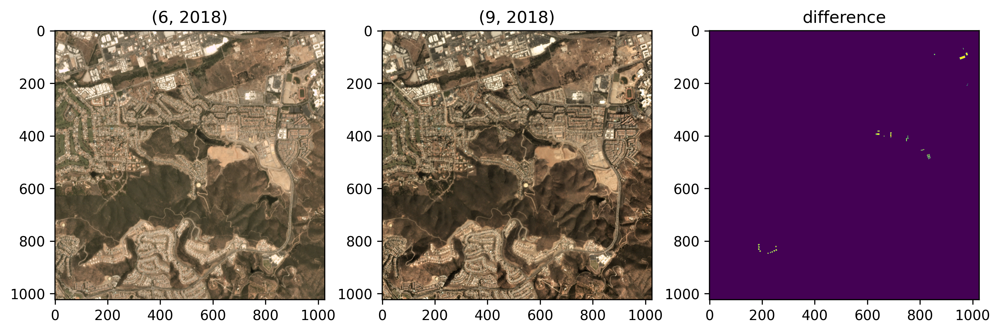

In [ ]:
plot_sample(train_set[10])

In [ ]:
train_set_512 = MultiTemporalSatelliteDataset(root_dir=root_dir,csv_file=csv_file,chip_dimension=512)

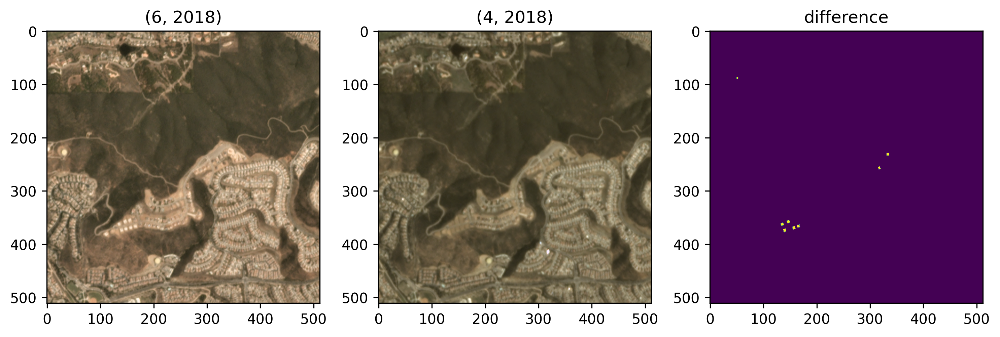

In [ ]:
plot_sample(train_set_512[10])

# Data aug

In [ ]:
!pip install -U albumentations

In [ ]:
class ToTensor(object):
    """Convert ndarrays in sample to Tensors."""

    def __call__(self, sample):
        raster_diff, mask_diff = sample['raster_diff'], sample['mask_diff']
        sample['raster_diff'] = torch.from_numpy(raster_diff)
        sample['mask_diff'] = torch.from_numpy(mask_diff)
        
        return sample
        
class AsImage(object):
    """Convert shape of image from (Channels,Rows,Columns) to (Rows,Column,Channels)."""

    def __call__(self, sample):
        raster_diff, mask_diff = sample['raster_diff'], sample['mask_diff']
        sample['raster_diff'] = torch.from_numpy(raster_diff)
        sample['mask_diff'] = torch.from_numpy(mask_diff)
        
        return sample

In [ ]:
import albumentations as A
from albumentations.pytorch import ToTensorV2

A.Normalize(mean=[0.485, 0.456, 0.406],std=[0.229, 0.224, 0.225])
A.Rotate(limit=(-360, 360), interpolation=4, border_mode=4,p=0),

(Rotate(always_apply=False, p=0, limit=(-360, 360), interpolation=4, border_mode=4, value=None, mask_value=None),)

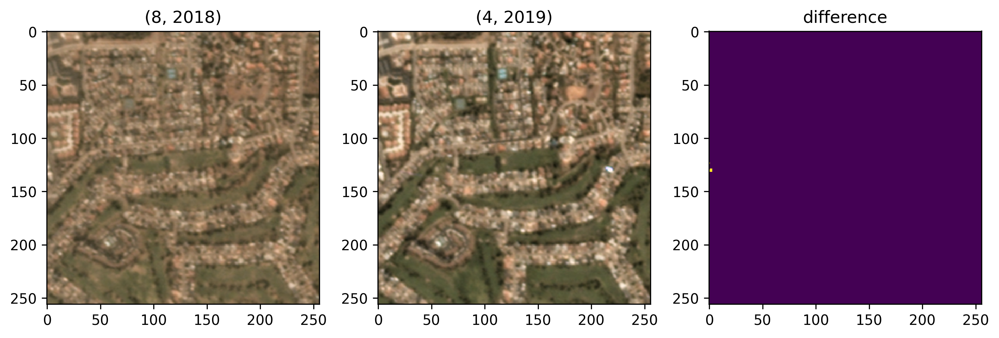

In [ ]:
chip_dimension = 256

transform = A.Compose(
    [
        A.PadIfNeeded(min_height=chip_dimension,min_width=chip_dimension,value=0,p=1),
        A.RandomRotate90(p=1.0),
        ToTensorV2()
    ]
)


In [ ]:

train_set_64 = MultiTemporalSatelliteDataset(root_dir=root_dir,csv_file=csv_file,chip_dimension=chip_dimension,transform=transform)

plot_sample(train_set_64[500])

In [ ]:
root_dir

PosixPath('/content/drive/MyDrive/Colab Notebooks/SPACENET7/DATASET/dataset_pruebas/train')

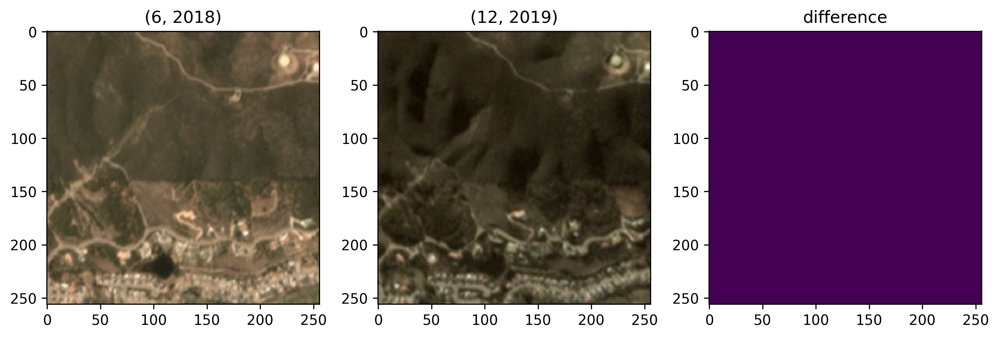

In [ ]:
plot_sample(train_set_64[328])

In [ ]:
dataloader = DataLoader(train_set_64, batch_size=8,
                        shuffle=True, num_workers=0)

batch = next(iter(dataloader))

batch['raster_diff'].shape

torch.Size([8, 6, 256, 256])

In [ ]:
dataloader.dataset.n_chips

16